<a href="https://colab.research.google.com/github/Prax0028/UnderstandingMachineLearningAlgorithms_-PESU-IO-14/blob/main/UMLA_Project.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# SPOTIFY TRACKS 

## Importing modules and dataset

In [ ]:
import os
import numpy as np
import pandas as pd
import random
import matplotlib.pyplot as plt
import seaborn as sns

In [ ]:
from sklearn.linear_model import LinearRegression
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import LabelEncoder

In [ ]:
df = pd.read_csv("/content/dataset.csv")


## Data Visualization

In [ ]:
df.head(10)

,Unnamed: 0,track_id,artists,album_name,track_name,popularity,duration_ms,explicit,danceability,energy,...,loudness,mode,speechiness,acousticness,instrumentalness,liveness,valence,tempo,time_signature,track_genre
0,0,5SuOikwiRyPMVoIQDJUgSV,Gen Hoshino,Comedy,Comedy,73,230666,False,0.676,0.4610,...,-6.746,0,0.1430,0.0322,0.000001,0.3580,0.7150,87.917,4,acoustic
1,1,4qPNDBW1i3p13qLCt0Ki3A,Ben Woodward,Ghost (Acoustic),Ghost - Acoustic,55,149610,False,0.420,0.1660,...,-17.235,1,0.0763,0.9240,0.000006,0.1010,0.2670,77.489,4,acoustic
2,2,1iJBSr7s7jYXzM8EGcbK5b,Ingrid Michaelson;ZAYN,To Begin Again,To Begin Again,57,210826,False,0.438,0.3590,...,-9.734,1,0.0557,0.2100,0.000000,0.1170,0.1200,76.332,4,acoustic
3,3,6lfxq3CG4xtTiEg7opyCyx,Kina Grannis,Crazy Rich Asians (Original Motion Picture Sou...,Can't Help Falling In Love,71,201933,False,0.266,0.0596,...,-18.515,1,0.0363,0.9050,0.000071,0.1320,0.1430,181.740,3,acoustic
4,4,5vjLSffimiIP26QG5WcN2K,Chord Overstreet,Hold On,Hold On,82,198853,False,0.618,0.4430,...,-9.681,1,0.0526,0.4690,0.000000,0.0829,0.1670,119.949,4,acoustic
5,5,01MVOl9KtVTNfFiBU9I7dc,Tyrone Wells,Days I Will Remember,Days I Will Remember,58,214240,False,0.688,0.4810,...,-8.807,1,0.1050,0.2890,0.000000,0.1890,0.6660,98.017,4,acoustic
6,6,6Vc5wAMmXdKIAM7WUoEb7N,A Great Big World;Christina Aguilera,Is There Anybody Out There?,Say Something,74,229400,False,0.407,0.1470,...,-8.822,1,0.0355,0.8570,0.000003,0.0913,0.0765,141.284,3,acoustic
7,7,1EzrEOXmMH3G43AXT1y7pA,Jason Mraz,We Sing. We Dance. We Steal Things.,I'm Yours,80,242946,False,0.703,0.4440,...,-9.331,1,0.0417,0.5590,0.000000,0.0973,0.7120,150.960,4,acoustic
8,8,0IktbUcnAGrvD03AWnz3Q8,Jason Mraz;Colbie Caillat,We Sing. We Dance. We Steal Things.,Lucky,74,189613,False,0.625,0.4140,...,-8.700,1,0.0369,0.2940,0.000000,0.1510,0.6690,130.088,4,acoustic
9,9,7k9GuJYLp2AzqokyEdwEw2,Ross Copperman,Hunger,Hunger,56,205594,False,0.442,0.6320,...,-6.770,1,0.0295,0.4260,0.004190,0.0735,0.1960,78.899,4,acoustic


In [ ]:
df.shape


(114000, 21)

In [ ]:
df.isnull().sum()

Unnamed: 0          0
track_id            0
artists             1
album_name          1
track_name          1
popularity          0
duration_ms         0
explicit            0
danceability        0
energy              0
key                 0
loudness            0
mode                0
speechiness         0
acousticness        0
instrumentalness    0
liveness            0
valence             0
tempo               0
time_signature      0
track_genre         0
dtype: int64

In [ ]:
df[df["artists"].isnull()]

,Unnamed: 0,track_id,artists,album_name,track_name,popularity,duration_ms,explicit,danceability,energy,...,loudness,mode,speechiness,acousticness,instrumentalness,liveness,valence,tempo,time_signature,track_genre
65900,65900,1kR4gIb7nGxHPI3D2ifs59,NaN,NaN,NaN,0,0,False,0.501,0.583,...,-9.46,0,0.0605,0.69,0.00396,0.0747,0.734,138.391,4,k-pop


In [ ]:
df.drop([65900], inplace=True)

In [ ]:
df.shape

(113999, 21)

In [ ]:
print(df['artists'].unique())
print()
print()
print(df['album_name'].unique())
print()
print()
print(df['track_genre'].unique())

['Gen Hoshino' 'Ben Woodward' 'Ingrid Michaelson;ZAYN' ...
 'Cuencos Tibetanos Sonidos Relajantes'
 'Bryan & Katie Torwalt;Brock Human' 'Jesus Culture']


['Comedy' 'Ghost (Acoustic)' 'To Begin Again' ...
 '#20 Sueños Vividos - Música Intrumental Suave 2018 para Dormir Bien y Relajarse Profundamente'
 'Frecuencias Álmicas en 432hz (Solo Piano)' 'Revelation Songs']


['acoustic' 'afrobeat' 'alt-rock' 'alternative' 'ambient' 'anime'
 'black-metal' 'bluegrass' 'blues' 'brazil' 'breakbeat' 'british'
 'cantopop' 'chicago-house' 'children' 'chill' 'classical' 'club' 'comedy'
 'country' 'dance' 'dancehall' 'death-metal' 'deep-house' 'detroit-techno'
 'disco' 'disney' 'drum-and-bass' 'dub' 'dubstep' 'edm' 'electro'
 'electronic' 'emo' 'folk' 'forro' 'french' 'funk' 'garage' 'german'
 'gospel' 'goth' 'grindcore' 'groove' 'grunge' 'guitar' 'happy'
 'hard-rock' 'hardcore' 'hardstyle' 'heavy-metal' 'hip-hop' 'honky-tonk'
 'house' 'idm' 'indian' 'indie-pop' 'indie' 'industrial' 'iranian'
 'j-dance'

In [ ]:
print(df['artists'].value_counts())
print()
print()
print(df['album_name'].value_counts())
print()
print()
print(df['track_genre'].value_counts())

The Beatles                                                                 279
George Jones                                                                271
Stevie Wonder                                                               236
Linkin Park                                                                 224
Ella Fitzgerald                                                             222
                                                                           ... 
Automatic Tasty                                                               1
o9                                                                            1
Pyotr Ilyich Tchaikovsky;National Philharmonic Orchestra;Richard Bonynge      1
tstewart;Ólafur Arnalds                                                       1
Jesus Culture                                                                 1
Name: artists, Length: 31437, dtype: int64


Alternative Christmas 2022     195
Feliz Cumpleaños con Perreo    184
Metal

In [ ]:
#df['artists'].value_counts().plot(kind='bar',figsize=(16,9),color=(0.2, 0.3, 0.2, 0.8))

In [ ]:
genre_popularity_score = df.groupby('track_genre')['popularity'].mean().sort_values(ascending = False).head(12)
genre_popularity_score

track_genre
pop-film             59.283000
k-pop                56.952953
chill                53.651000
sad                  52.379000
grunge               49.594000
indian               49.539000
anime                48.772000
emo                  48.128000
sertanejo            47.866000
pop                  47.576000
progressive-house    46.615000
piano                45.273000
Name: popularity, dtype: float64

Text(0, 0.5, 'Popularity (0-100)')

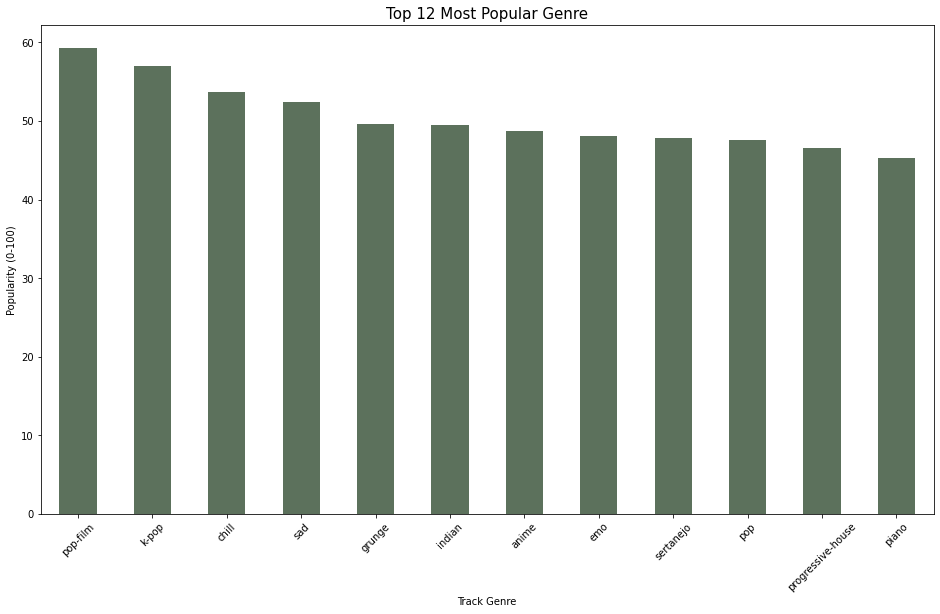

In [ ]:
genre_popularity_score.plot(kind='bar',figsize=(16,9),color=(0.2, 0.3, 0.2, 0.8))
plt.title("Top 12 Most Popular Genre", size = 15)
plt.xticks(rotation=45)
plt.xlabel("Track Genre")
plt.ylabel("Popularity (0-100)")

In [ ]:
artist_popularity_score = df.groupby('artists')['popularity'].mean().sort_values(ascending = False).head(12)
artist_popularity_score

artists
Sam Smith;Kim Petras           100.0
Bizarrap;Quevedo                99.0
Manuel Turizo                   98.0
Bad Bunny;Chencho Corleone      97.0
Bad Bunny;Bomba Estéreo         94.5
Joji                            94.0
Beyoncé                         93.0
Rema;Selena Gomez               92.0
Harry Styles                    92.0
Rauw Alejandro;Lyanno;Brray     91.0
Drake;21 Savage                 91.0
Luar La L                       90.5
Name: popularity, dtype: float64

Text(0, 0.5, 'Popularity (0-100)')

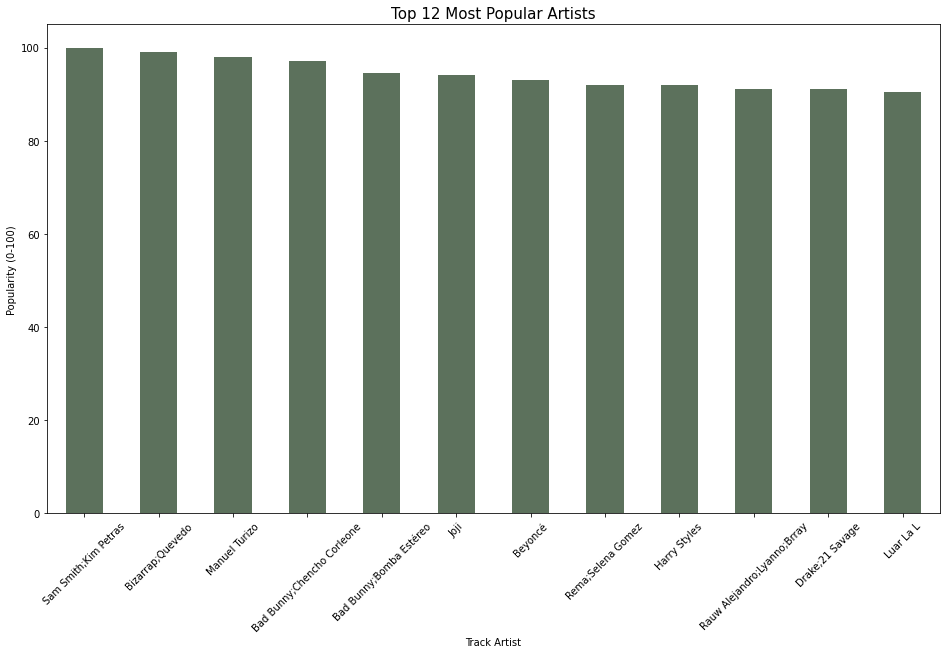

In [ ]:
artist_popularity_score.plot(kind='bar',figsize=(16,9),color=(0.2, 0.3, 0.2, 0.8))
plt.title("Top 12 Most Popular Artists", size = 15)
plt.xticks(rotation=45)
plt.xlabel("Track Artist")
plt.ylabel("Popularity (0-100)")

In [ ]:
idx = df.groupby('track_genre')['popularity'].transform(max) == df['popularity']
mostPopularTrack = df[idx].drop_duplicates(['track_genre'])
mostPopularTrack = mostPopularTrack.drop_duplicates(['track_name'])
mostPopularTrack.sort_values('popularity', ascending=False, inplace=True)
mostPopularTrack = mostPopularTrack[['track_name','artists', 'track_genre', 'popularity']]
pd.set_option('display.max_rows', None)
mostPopularTrack.style.hide_index()

track_name,artists,track_genre,popularity
Unholy (feat. Kim Petras),Sam Smith;Kim Petras,dance,100
"Quevedo: Bzrp Music Sessions, Vol. 52",Bizarrap;Quevedo,hip-hop,99
I'm Good (Blue),David Guetta;Bebe Rexha,edm,98
La Bachata,Manuel Turizo,latin,98
I Ain't Worried,OneRepublic,piano,96
Sweater Weather,The Neighbourhood,alt-rock,93
Another Love,Tom Odell,chill,93
I Wanna Be Yours,Arctic Monkeys,garage,92
Atlantis,Seafret,folk,90
Running Up That Hill (A Deal With God),Kate Bush,r-n-b,90


In [ ]:
artist_genre=df.groupby('artists')['track_genre'].value_counts()
artist_genre

artists                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                            track_genre      
!nvite                                                                                                                                                                                                                                                                                                                                                                                                                                                                             

In [ ]:
df.drop(["track_id","track_name","artists","album_name"], axis = 1, inplace=True)

In [ ]:
df.drop(df.columns[0], axis = 1, inplace = True)

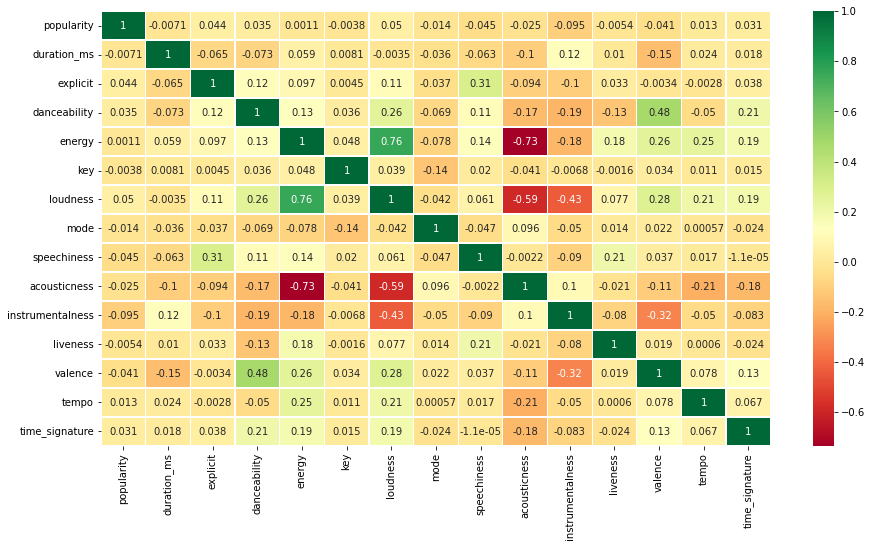

In [ ]:
sns.heatmap(df.corr(),annot=True,cmap='RdYlGn',linewidths=0.2) #data.corr()-->correlation matrix
fig=plt.gcf()
fig.set_size_inches(15,8)
plt.show()

Text(0, 0.5, 'popularity')

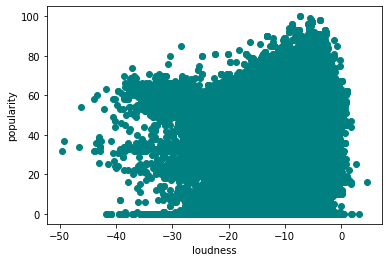

In [ ]:
plt.scatter(df['loudness'].values, df['popularity'], color='teal')
plt.xlabel('loudness')
plt.ylabel('popularity')

Text(0, 0.5, 'popularity')

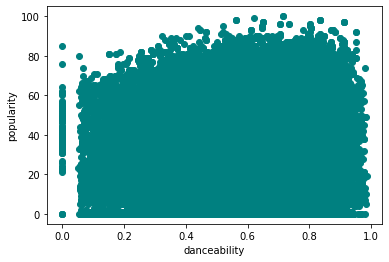

In [ ]:
plt.scatter(df['danceability'].values, df['popularity'], color='teal')
plt.xlabel('danceability')
plt.ylabel('popularity')

Text(0, 0.5, 'popularity')

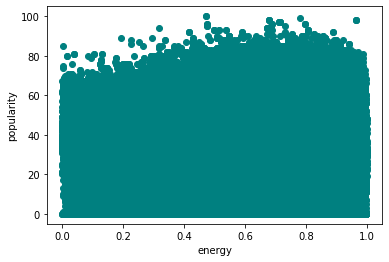

In [ ]:
plt.scatter(df['energy'].values, df['popularity'], color='teal')
plt.xlabel('energy')
plt.ylabel('popularity')

Text(0, 0.5, 'popularity')

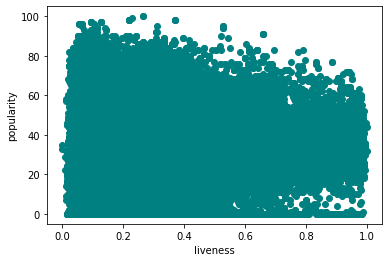

In [ ]:
plt.scatter(df['liveness'].values,df['popularity'], color='teal')
plt.xlabel('liveness')
plt.ylabel('popularity')

In [ ]:
plt.scatter(df['tempo'].values,df['popularity'], color='teal')
plt.xlabel('tempo')
plt.ylabel('popularity')

## Preprocessing

In [ ]:
def labelencoder(df):
    for c in df.columns:
        if df[c].dtype=='object': 
            df[c] = df[c].fillna('N')
            lbl = LabelEncoder()
            lbl.fit(list(df[c].values))
            df[c] = lbl.transform(df[c].values)
    return df

In [ ]:
cleanup_nums = {"explicit": {"False":0 , "True":1}
               }

In [ ]:
df = labelencoder(df)
df=df.replace(cleanup_nums)
df.head()

## Models

In [ ]:
X = df.drop(columns = ['popularity']).values
y = df['popularity'].values
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size = 0.2, random_state = 0)

### Multiple Linear Regression

In [ ]:
regressor = LinearRegression()
regressor.fit(X_train, y_train)

In [ ]:
#predictions
y_pred = regressor.predict(X_test)
np.set_printoptions(precision=2)
print(np.concatenate((y_pred.reshape(len(y_pred),1), y_test.reshape(len(y_test),1)),1))

In [ ]:
y_pred

In [ ]:
y_test

In [ ]:
print(f'Training Acc {round(regressor.score(X_train, y_train) * 100, 2)}%')
print(f'Testing Acc {round(regressor.score(X_test, y_test) * 100, 2)}%')

### Decision Tree

In [ ]:
from sklearn.tree import DecisionTreeRegressor
dtregressor = DecisionTreeRegressor(random_state = 0)
dtregressor.fit(X_train, y_train)

In [ ]:
y_pred_dt = dtregressor.predict(X_test)

In [ ]:
y_pred_dt

In [ ]:
y_test

In [ ]:
print(f'Training Acc {round(dtregressor.score(X_train, y_train) * 100, 2)}%')
print(f'Testing Acc {round(dtregressor.score(X_test, y_test) * 100, 2)}%')

### Random Forests

In [ ]:
from sklearn.ensemble import RandomForestRegressor
rfregressor = RandomForestRegressor(n_estimators = 10, random_state = 0)
rfregressor.fit(X, y)

In [ ]:
y_pred_rf = rfregressor.predict(X_test)

In [ ]:
y_pred_rf

In [ ]:
y_test

In [ ]:
print(f'Training Acc {round(rfregressor.score(X_train, y_train) * 100, 2)}%')
print(f'Testing Acc {round(rfregressor.score(X_test, y_test) * 100, 2)}%')

### Support Vector Regression

In [ ]:
from sklearn.svm import SVR
svregressor = SVR(kernel = 'rbf')
svregressor.fit(X, y)

SVR()

In [ ]:
y_pred_svr = svregressor.predict(X_test)

In [ ]:
y_pred_svr

array([37.1 , 36.88, 37.43, ..., 36.52, 36.83, 37.12])

In [ ]:
y_test

array([51,  0, 51, ..., 24, 44, 58])

In [ ]:
print(f'Training Acc {round(svregressor.score(X_train, y_train) * 100, 2)}%')
print(f'Testing Acc {round(svregressor.score(X_test, y_test) * 100, 2)}%')

Training Acc 0.15%
Testing Acc 0.62%


In [ ]:
svregressor_lin = SVR(kernel = 'linear')
svregressor_lin.fit(X, y)

In [ ]:
y_pred_svr_lin = svregressor_lin.predict(X_test)

In [ ]:
print(f'Training Acc {round(svregressor_lin.score(X_train, y_train) * 100, 2)}%')
print(f'Testing Acc {round(svregressor_lin.score(X_test, y_test) * 100, 2)}%')

In [ ]:
svregressor_poly = SVR(kernel = 'poly')
svregressor_poly.fit(X, y)

In [ ]:
y_pred_svr_poly = svregressor_poly.predict(X_test)

In [ ]:
print(f'Training Acc {round(svregressor_poly.score(X_train, y_train) * 100, 2)}%')
print(f'Testing Acc {round(svregressor_poly.score(X_test, y_test) * 100, 2)}%')